# Project 1 - California Fire & Weather Analysis

## Table of Contents

1. [Data Preparation](#Data-Preparation)<br>
    1.1 [Importing Dependencies](#Importing-Dependencies)<br>
    1.2 [Importing Clean Data](#Importing-Clean-Data)<br>
    1.3 [Create groups for analysis](#Create-groups-for-analysis)<br>
    1.4 [Create Mapping Dataframe with County Boundaries](#Create-Mapping-Dataframe-with-County-Boundaries)<br>
2. [Analysis](#Analysis)<br>
    2.1 [Fire, Rain and Temperature Trends](#Fire,-Rain-and-Temperature-Trends)<br>
        - 2.1.1 [Mean Acres Burned vs Mean Rainfall - County Level Correlation](#Mean-Acres-Burned-vs-Mean-Rainfall---County-Level-Correlation)<br>
        - 2.1.2 [Average Annual Rainfall by County](#Average-Annual-Rainfall-by-County)<br>
        - 2.1.3 [Mean Acres Burned vs Mean Temperature - County Level Correlation](#Mean-Acres-Burned-vs-Mean-Temperature---County-Level-Correlation)<br>
        - 2.1.4 [Average Annual Max Temperature (F) by County](#Average-Annual-Max-Temperature-(F)-by-County)<br>
        - 2.1.5 [Average Annual Temperature (F) by County with Total Acred Burned](#Average-Annual-Temperature-(F)-by-County-with-Total-Acred-Burned)<br>
    2.2 [Relationship between Fire and Weather](#Relationship-between-Fire-and-Weather)<br>
        - 2.2.1 [Total Monthly Rainfall vs. Acres Burned](#Total-Monthly-Rainfall-vs.-Acres-Burned)<br>
        - 2.2.2 [Max Monthly Temperature vs. Acres Burned](#Max-Monthly-Temperature-vs.-Acres-Burned)<br>
        - 2.2.3 [Fire Duration vs Total Rainfall](#Fire-Duration-vs-Total-Rainfall)<br>
        - 2.2.4 [Fire Duaration vs Max Temperature](#Fire-Duaration-vs-Max-Temperature)<br>
        - 2.2.5 [Average Rainfall vs Total Fire Incidents by Year](#Average-Rainfall-vs-Total-Fire-Incidents-by-Year)<br>
        - 2.2.6 [Max Temperature vs Total Fire Incidents by Year](#Max-Temperature-vs-Total-Fire-Incidents-by-Year)<br>
        - 2.2.7 [Average Rainfall vs Total Fire Incidents by Month](#Average-Rainfall-vs-Total-Fire-Incidents-by-Month)<br>
        - 2.2.8 [Max Temperature vs Total Fire Incidents by Month](#Max-Temperature-vs-Total-Fire-Incidents-by-Month)<br>
        - 2.2.9 [Average Duration vs Average Acres Burned](#Average-Duration-vs-Average-Acres-Burned)<br>
        - 2.2.10 [Statistical Summaries of Monthly Fire and Weather Variables](#Statistical-Summaries-of-Monthly-Fire-and-Weather-Variables)<br>
    2.3 [Top 5 Counties Affected by Fire](#Top-5-Counties-Affected-by-Fire)<br>
        - 2.3.1 [Fire Incident Count per Year for Top 5 Counties](#Fire-Incident-Count-per-Year-for-Top-5-Counties)<br>
        - 2.3.2 [Average Annual Max Temperature (F) and Top 5 Counties by Total Acres Burned](#Average-Annual-Max-Temperature-(F)-and-Top-5-Counties-by-Total-Acres-Burned)<br>

## Data Preparation

### Importing Dependencies

In [1]:
# Dependencies and Setup
import pandas as pd
import scipy.stats as stats
import matplotlib.pyplot as plt
from scipy.stats import linregress
import hvplot.pandas
import geopandas as gpd
import matplotlib.cm as cm

### Importing Clean Data

In [2]:
fire_df = pd.read_csv("Resources/fire_data/fire_all_grouped.csv", index_col="City_ID")

In [3]:
fire_ungrouped_df = pd.read_csv("Resources/fire_data/fire_all_ungrouped.csv", index_col="City_ID")

In [4]:
rainfall_df = pd.read_csv("Resources/weather_data/rainfall_all_years_clean.csv", index_col="City_ID")

In [5]:
temperature_df = pd.read_csv("Resources/weather_data/temperature_all_years_clean.csv", index_col="City_ID")

In [6]:
fire_vs_rain = pd.merge(fire_df, rainfall_df, on=["Month", "Year", "County"], how="left")

In [7]:
fire_rain_temp_df = pd.merge(fire_vs_rain, temperature_df, on=["Month", "Year", "County"], how="left").dropna()

### Create groups for analysis

In [8]:
gb_year = fire_rain_temp_df.groupby("Year")
gb_year = gb_year.agg(
    #Sum of total incidents
    Incident_Tot = ("Incident Count Tot","sum"), 
    
    #total acre burned
    Acres_Burned_Tot = ("Acres Burned Tot", "sum"),

    #avg acres burned 
    Acres_Burned_Avg = ("Acres Burned Avg", lambda x: round(x.mean(), 2)),

    #avg duration
    Duration_Avg_days = ("Fire Duration Avg (days)", lambda x: round(x.mean(), 1)),

    #total rainfall
    Rainfall_Tot_inches = ("Rainfall (inches)", lambda x: round(x.sum(), 2)),

    #avg rainfall
    Rainfall_Avg_inches = ("Rainfall (inches)", lambda x: round(x.mean(), 2)),

    #avg temperature
    Temperature_Avg_F = ("Temperature (F)", lambda x: round(x.mean(), 1))
).reset_index()

gb_year.head()

,Year,Incident_Tot,Acres_Burned_Tot,Acres_Burned_Avg,Duration_Avg_days,Rainfall_Tot_inches,Rainfall_Avg_inches,Temperature_Avg_F
0,2013,144,496671.0,2945.79,3.8,40.32,0.42,82.7
1,2014,78,296982.0,2010.65,8.0,26.44,0.47,83.2
2,2015,98,412281.0,4412.51,6.6,31.61,0.43,85.3
3,2016,156,452101.0,2565.61,8.7,37.30,0.36,84.7
4,2017,432,1258294.0,3290.30,158.0,87.34,0.47,83.2


In [9]:
gb_month = fire_rain_temp_df.groupby(["Month created (num)", "Month"])
gb_month = gb_month.agg(
    #Sum of total incidents
    Incident_Tot = ("Incident Count Tot","sum"), 
    
    #total acre burned
    Acres_Burned_Tot = ("Acres Burned Tot", "sum"),

    #avg acres burned 
    Acres_Burned_Avg = ("Acres Burned Avg", lambda x: round(x.mean(), 2)),

    #avg duration
    Duration_Avg_days = ("Fire Duration Avg (days)", lambda x: round(x.mean(), 1)),

    #total rainfall
    Rainfall_Tot_inches = ("Rainfall (inches)", lambda x: round(x.sum(), 2)),

    #avg rainfall
    Rainfall_Avg_inches = ("Rainfall (inches)", lambda x: round(x.mean(), 2)),

    #avg temperature
    Temperature_Avg_F = ("Temperature (F)", lambda x: round(x.mean(), 1))
).reset_index()

gb_month.head()

,Month created (num),Month,Incident_Tot,Acres_Burned_Tot,Acres_Burned_Avg,Duration_Avg_days,Rainfall_Tot_inches,Rainfall_Avg_inches,Temperature_Avg_F
0,1,January,11,4685.0,465.65,4.7,29.66,2.97,61.1
1,2,February,11,7308.0,664.36,93.0,24.47,2.22,58.5
2,3,March,12,2228.0,196.95,53.9,26.72,2.43,63.5
3,4,April,44,14373.0,263.63,81.7,47.13,1.27,72.1
4,5,May,165,125631.0,641.57,74.8,56.93,0.59,77.1


In [10]:
gb_year_county = fire_rain_temp_df.groupby(["Year", "County"])
gb_year_county = gb_year_county.agg(
    #Sum of total incidents
    Incident_Tot = ("Incident Count Tot","sum"), 
    
    #total acre burned
    Acres_Burned_Tot = ("Acres Burned Tot", "sum"),

    #avg acres burned 
    Acres_Burned_Avg = ("Acres Burned Avg", lambda x: round(x.mean(), 2)),

    #avg duration
    Duration_Avg_days = ("Fire Duration Avg (days)", lambda x: round(x.mean(), 1)),

    #total rainfall
    Rainfall_Tot_inches = ("Rainfall (inches)", lambda x: round(x.sum(), 2)),

    #avg rainfall
    Rainfall_Avg_inches = ("Rainfall (inches)", lambda x: round(x.mean(), 2)),

    #avg temperature
    Temperature_Avg_F = ("Temperature (F)", lambda x: round(x.mean(), 1))
).reset_index()
                                           
gb_year_county.head()

,Year,County,Incident_Tot,Acres_Burned_Tot,Acres_Burned_Avg,Duration_Avg_days,Rainfall_Tot_inches,Rainfall_Avg_inches,Temperature_Avg_F
0,2013,Alameda,3,328.0,142.00,0.0,0.12,0.06,82.4
1,2013,Amador,1,96.0,96.00,1.0,0.74,0.74,85.7
2,2013,Butte,5,3039.0,471.67,1.4,1.90,0.63,84.1
3,2013,Calaveras,2,77.0,38.50,1.5,0.01,0.00,91.4
4,2013,Colusa,1,7.0,7.00,4.0,0.45,0.45,90.5


In [11]:
gb_month_year = fire_rain_temp_df.groupby(["Month created (num)", "Month", "Year"])
gb_month_year = gb_month_year.agg(
    #Sum of total incidents
    Incident_Tot = ("Incident Count Tot","sum"), 
    
    #total acre burned
    Acres_Burned_Tot = ("Acres Burned Tot", "sum"),

    #avg acres burned 
    Acres_Burned_Avg = ("Acres Burned Avg", lambda x: round(x.mean(), 2)),

    #avg duration
    Duration_Avg_days = ("Fire Duration Avg (days)", lambda x: round(x.mean(), 1)),

    #total rainfall
    Rainfall_Tot_inches = ("Rainfall (inches)", lambda x: round(x.sum(), 2)),

    #avg rainfall
    Rainfall_Avg_inches = ("Rainfall (inches)", lambda x: round(x.mean(), 2)),

    #avg temperature
    Temperature_Avg_F = ("Temperature (F)", lambda x: round(x.mean(), 1))
).reset_index()
                                           
gb_month_year.head()                   

,Month created (num),Month,Year,Incident_Tot,Acres_Burned_Tot,Acres_Burned_Avg,Duration_Avg_days,Rainfall_Tot_inches,Rainfall_Avg_inches,Temperature_Avg_F
0,1,January,2014,4,3256.0,814.0,6.0,2.94,0.74,62.5
1,1,January,2019,1,30.0,30.0,14.0,12.30,12.30,52.7
2,1,January,2021,6,1399.0,274.1,1.8,14.42,2.88,61.7
3,2,February,2013,1,407.0,407.0,4.0,0.03,0.03,57.8
4,2,February,2015,1,200.0,200.0,6.0,7.72,7.72,52.8


In [12]:
gb_month_county = fire_rain_temp_df.groupby(["County", "Month created (num)", "Month"])
gb_month_county = gb_month_county.agg(
    #Sum of total incidents
    Incident_Tot = ("Incident Count Tot","sum"), 
    
    #total acre burned
    Acres_Burned_Tot = ("Acres Burned Tot", "sum"),

    #avg acres burned 
    Acres_Burned_Avg = ("Acres Burned Avg", lambda x: round(x.mean(), 2)),

    #avg duration
    Duration_Avg_days = ("Fire Duration Avg (days)", lambda x: round(x.mean(), 1)),

    #total rainfall
    Rainfall_Tot_inches = ("Rainfall (inches)", lambda x: round(x.sum(), 2)),

    #avg rainfall
    Rainfall_Avg_inches = ("Rainfall (inches)", lambda x: round(x.mean(), 2)),

    #avg temperature
    Temperature_Avg_F = ("Temperature (F)", lambda x: round(x.mean(), 1))
).reset_index()

gb_month_county.head()

,County,Month created (num),Month,Incident_Tot,Acres_Burned_Tot,Acres_Burned_Avg,Duration_Avg_days,Rainfall_Tot_inches,Rainfall_Avg_inches,Temperature_Avg_F
0,Alameda,5,May,2,496.0,248.00,227.0,0.02,0.02,70.6
1,Alameda,6,June,5,1053.0,210.60,114.0,0.19,0.04,81.8
2,Alameda,7,July,10,1211.0,117.67,29.2,0.00,0.00,84.3
3,Alameda,8,August,9,82712.8,13745.47,54.8,0.10,0.02,85.0
4,Alameda,9,September,3,188.0,49.75,75.8,0.25,0.12,81.8


In [13]:
gb_county = fire_rain_temp_df.groupby(["County"])
gb_county = gb_county.agg(
    #Sum of total incidents
    Incident_Tot = ("Incident Count Tot","sum"), 
    
    #total acre burned
    Acres_Burned_Tot = ("Acres Burned Tot", "sum"),

    #avg acres burned 
    Acres_Burned_Avg = ("Acres Burned Avg", lambda x: round(x.mean(), 2)),

    #avg duration
    Duration_Avg_days = ("Fire Duration Avg (days)", lambda x: round(x.mean(), 1)),

    #total rainfall
    Rainfall_Tot_inches = ("Rainfall (inches)", lambda x: round(x.sum(), 2)),

    #avg rainfall
    Rainfall_Avg_inches = ("Rainfall (inches)", lambda x: round(x.mean(), 2)),

    #avg temperature
    Temperature_Avg_F = ("Temperature (F)", lambda x: round(x.mean(), 1))
).reset_index()

gb_county.head()

,County,Incident_Tot,Acres_Burned_Tot,Acres_Burned_Avg,Duration_Avg_days,Rainfall_Tot_inches,Rainfall_Avg_inches,Temperature_Avg_F
0,Alameda,33,85843.8,3684.30,69.1,3.48,0.15,81.6
1,Alpine,5,143902.0,28780.40,46.2,3.03,0.61,75.9
2,Amador,15,77851.0,5540.00,43.4,2.88,0.21,88.6
3,Butte,76,454306.8,8122.44,54.8,44.46,1.17,85.6
4,Calaveras,28,5076.0,193.87,42.2,1.91,0.09,88.5


In [14]:
gb_year_month_county = fire_rain_temp_df.groupby(["Year", "County", "Month created (num)", "Month"])
gb_year_month_county = gb_year_month_county.agg(
    #Sum of total incidents
    Incident_Tot = ("Incident Count Tot","sum"), 
    
    #total acre burned
    Acres_Burned_Tot = ("Acres Burned Tot", "sum"),

    #avg acres burned 
    Acres_Burned_Avg = ("Acres Burned Avg", lambda x: round(x.mean(), 2)),

    #avg duration
    Duration_Avg_days = ("Fire Duration Avg (days)", lambda x: round(x.mean(), 1)),

    #total rainfall
    Rainfall_Tot_inches = ("Rainfall (inches)", lambda x: round(x.sum(), 2)),

    #avg temperature
    Max_Temperature_F = ("Temperature (F)", lambda x: round(x, 1)),
    
).reset_index()

gb_year_month_county.head()

,Year,County,Month created (num),Month,Incident_Tot,Acres_Burned_Tot,Acres_Burned_Avg,Duration_Avg_days,Rainfall_Tot_inches,Max_Temperature_F
0,2013,Alameda,6,June,1,240.0,240.0,0.0,0.12,80.8
1,2013,Alameda,7,July,2,88.0,44.0,0.0,0.00,83.9
2,2013,Amador,6,June,1,96.0,96.0,1.0,0.74,85.7
3,2013,Butte,6,June,1,298.0,298.0,0.0,1.42,87.6
4,2013,Butte,8,August,3,2436.0,812.0,3.3,0.03,89.9


### Create Mapping Dataframe with County Boundaries

In [15]:
# Load California county boundaries
county_boundaries = gpd.read_file('Resources/mapping/ca_county_boundaries/ca_county_boundaries.shp')
county_boundaries.rename(columns={'NAME': 'County','INTPTLAT': "Centroid_LAT", 'INTPTLON': "Centroid_LON"}, inplace=True)
clean_county_boundaries = county_boundaries[['County', 'Centroid_LAT', 'Centroid_LON', 'geometry']]
clean_county_boundaries.head()

,County,Centroid_LAT,Centroid_LON,geometry
0,Sierra,+39.5769252,-120.5219926,"POLYGON ((-120.556 39.509, -120.556 39.510, -1..."
1,Sacramento,+38.4501363,-121.3443291,"POLYGON ((-121.440 38.256, -121.440 38.256, -1..."
2,Santa Barbara,+34.5366774,-120.0383645,"MULTIPOLYGON (((-120.582 34.108, -120.579 34.1..."
3,Calaveras,+38.1910682,-120.5541065,"POLYGON ((-120.632 38.346, -120.631 38.348, -1..."
4,Ventura,+34.3587477,-119.1331453,"MULTIPOLYGON (((-119.636 33.281, -119.635 33.2..."


In [16]:
# Merge county boundaries to county weather dataframe
rain_temp_mapping = pd.merge(clean_county_boundaries, gb_county, how='left', on='County')
rain_temp_mapping['Centroid_LAT'] = rain_temp_mapping['Centroid_LAT'].astype(float)
rain_temp_mapping['Centroid_LON'] = rain_temp_mapping['Centroid_LON'].astype(float)
rain_temp_mapping["Acres_Burned_Avg_scaled"] = rain_temp_mapping["Acres_Burned_Avg"] / 10
rain_temp_mapping.head()

,County,Centroid_LAT,Centroid_LON,geometry,Incident_Tot,Acres_Burned_Tot,Acres_Burned_Avg,Duration_Avg_days,Rainfall_Tot_inches,Rainfall_Avg_inches,Temperature_Avg_F,Acres_Burned_Avg_scaled
0,Sierra,39.576925,-120.521993,"POLYGON ((-120.556 39.509, -120.556 39.510, -1...",4.0,48046.0,12011.50,100.5,1.03,0.26,74.0,1201.150
1,Sacramento,38.450136,-121.344329,"POLYGON ((-121.440 38.256, -121.440 38.256, -1...",16.0,8185.5,590.08,44.2,0.23,0.02,92.7,59.008
2,Santa Barbara,34.536677,-120.038365,"MULTIPOLYGON (((-120.582 34.108, -120.579 34.1...",33.0,211906.5,3886.15,63.6,13.03,0.50,77.7,388.615
3,Calaveras,38.191068,-120.554107,"POLYGON ((-120.632 38.346, -120.631 38.348, -1...",28.0,5076.0,193.87,42.2,1.91,0.09,88.5,19.387
4,Ventura,34.358748,-119.133145,"MULTIPOLYGON (((-119.636 33.281, -119.635 33.2...",25.0,216254.0,9843.19,22.7,12.88,0.76,73.8,984.319


In [17]:
# Select for California Latitude and Longitude
cali_map_select = fire_ungrouped_df.loc[(fire_ungrouped_df["Lat"] > 32) & (fire_ungrouped_df["Lat"] < 42) & (fire_ungrouped_df["Lon"] > - 129) & (fire_ungrouped_df["Lon"] < -110)]
cali_map_select.head()

,Name,Year,Month,Month created (num),County,Acres burned,Duration (days),Lat,Lon
City_ID,,,,,,,,,
0,Bridge Fire,2017,October,10,Shasta,37.0,70.0,40.774000,-122.309000
2,River Fire,2013,February,2,Inyo,407.0,4.0,36.602575,-118.016510
3,Fawnskin Fire,2013,April,4,San Bernardino,30.0,2.0,34.288877,-116.941311
4,Gold Fire,2013,April,4,Madera,274.0,1.0,37.116295,-119.635004
5,Panther Fire,2013,May,5,Tehama,6896.0,8.0,40.190062,-121.595555


# Analysis

## Fire, Rain and Temperature Trends

What are the basic weather and fire trends in California over the past 10 years?

### Mean Acres Burned vs Mean Rainfall - County Level Correlation

The r-value is: 0.337286733063572


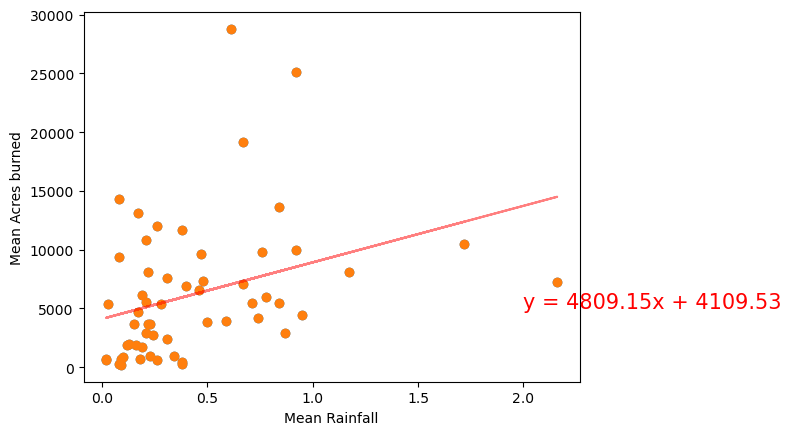

In [18]:
x = gb_county["Rainfall_Avg_inches"]
y = gb_county["Acres_Burned_Avg"]

plt.scatter(x,y)

(slope, intercept, rvalue, pvalue, stderr) = linregress(x, y)
regress_y = x * slope + intercept
print(f'The r-value is: {rvalue}')
line_equation = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
plt.scatter(x,y)
plt.plot(x,regress_y,"r", alpha=0.5)
plt.annotate(line_equation,(2, 5000),fontsize=15,color="red")
plt.ylabel("Mean Acres burned")
plt.xlabel("Mean Rainfall")

plt.show()

### Average Annual Rainfall by County

In [19]:
# Plot rainfall
cali_rainfall_plot = rain_temp_mapping.hvplot(
    geo=True, 
    c='Rainfall_Avg_inches', 
    cmap='Blues', 
    alpha=1,
    width=800, 
    height=600, 
    title="Average Annual Rainfall by County",
    hover_cols=['County', 'Rainfall_Avg_inches'],
    colorbar=True, 
    clabel = "Mean Rainfall (inches)")

# Display the map
cali_rainfall_plot

:Polygons   [Longitude,Latitude]   (Rainfall_Avg_inches,County)

### Mean Acres Burned vs Mean Temperature - County Level Correlation

The r-value is: -0.2906229879846919


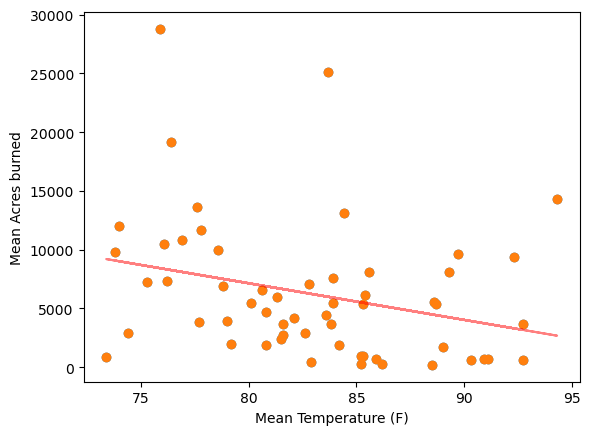

In [20]:
x = gb_county["Temperature_Avg_F"]
y = gb_county["Acres_Burned_Avg"]

plt.scatter(x,y)

(slope, intercept, rvalue, pvalue, stderr) = linregress(x, y)
regress_y = x * slope + intercept
print(f'The r-value is: {rvalue}')
line_equation = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
plt.scatter(x,y)
plt.plot(x,regress_y,"r", alpha=0.5)
plt.annotate(line_equation,(2, 5000),fontsize=15,color="red")
plt.ylabel("Mean Acres burned")
plt.xlabel("Mean Temperature (F)")

plt.show()

### Average Annual Max Temperature (F) by County

In [21]:
# Plot temperature
cali_maxtemp_plot = rain_temp_mapping.hvplot(
    geo=True, 
    c='Temperature_Avg_F', 
    cmap='Summer', 
    alpha=0.7,
    width=800, 
    height=600, 
    title="Average Annual Max Temperature (F) by County",
    hover_cols=['County', 'Temperature_Avg_F'],
    colorbar=True, 
    clabel = "Mean Temperature (F)")

# Display the map
cali_maxtemp_plot

:Polygons   [Longitude,Latitude]   (Temperature_Avg_F,County)

### Average Annual Rainfall with Total Incident Counts by County

In [22]:
# Plot Rainfall
cali_plot = rain_temp_mapping.hvplot(
    geo=True, 
    c='Rainfall_Avg_inches', 
    cmap='Blues', 
    alpha=1,
    width=800, 
    height=600, 
    title="Average Annual Rainfall with Total Incident Counts by County",
    hover_cols=['County', 'Rainfall_Avg_inches'],
    colorbar=True, 
    clabel = "Mean Rainfall (inches)")

# Plot fire locations
fire_locations = rain_temp_mapping.hvplot.points(
    'Centroid_LON', 
    'Centroid_LAT',
    geo = True,
    tiles = "OSM",
    frame_width = 700,
    frame_height = 500,
    size='Incident_Tot',
    scale=2.5,
    legend= "top",
    color='DarkOrange', 
    alpha=0.7,
    hover_cols=["County"])

# Display the map
combined_plot = cali_plot * fire_locations
combined_plot

:Overlay
   .Polygons.I :Polygons   [Longitude,Latitude]   (Rainfall_Avg_inches,County)
   .WMTS.I     :WMTS   [Longitude,Latitude]
   .Points.I   :Points   [Centroid_LON,Centroid_LAT]   (Incident_Tot,County)

### Average Annual Temperature (F) by County with Total Acred Burned

In [23]:
# Plot temperature
cali_maxtemp_plot2 = rain_temp_mapping.hvplot(
    geo=True, 
    c='Temperature_Avg_F', 
    cmap='Summer', 
    tiles = "OSM",
    alpha=0.7,
    width=800, 
    height=600, 
    title="Average Annual Temperature (F) by County with Total Acred Burned by Location",
    hover_cols=['County', 'Temperature_Avg_F'],
    colorbar=True, 
    clabel = "Mean Temperature (F)")

# Plot fire locations
fire_locations = cali_map_select.hvplot.points(
    'Lon', 
    'Lat',
    geo = True,
    tiles = "OSM",
    frame_width = 700,
    frame_height = 500,
    size='Acres burned',
    scale=0.05,
    color='red', 
    alpha=0.5,
    hover_cols=["County","Acres burned"],
    label='Acres burned')


# Display the map
combined_plot2 = cali_maxtemp_plot2 * fire_locations
combined_plot2

:Overlay
   .WMTS.I              :WMTS   [Longitude,Latitude]
   .Polygons.I          :Polygons   [Longitude,Latitude]   (Temperature_Avg_F,County)
   .WMTS.II             :WMTS   [Longitude,Latitude]
   .Points.Acres_burned :Points   [Lon,Lat]   (Acres burned,County)

## Relationship between Fire and Weather

What is the overall relationship between historical average monthly rainfall/average maximum temperatures and fire frequency, size and duration in counties across the state of California over the past 10 years?

### Total Monthly Rainfall vs. Acres Burned

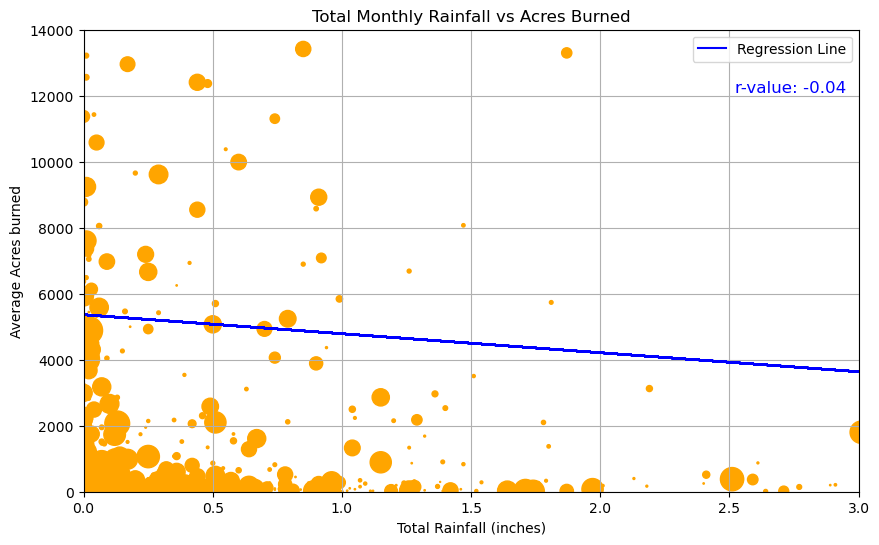

In [24]:
#Create Plot - Acres Burned vs Total Monthly Rainfall Scattor Plot by month
plt.figure(figsize=(10, 6))
plt.scatter(gb_year_month_county['Rainfall_Tot_inches'], gb_year_month_county['Acres_Burned_Avg'], s=gb_year_month_county['Duration_Avg_days'], color='orange', marker='o', alpha=1)
plt.xlim(0, 3)
plt.ylim(0, 14000)
plt.title('Total Monthly Rainfall vs Acres Burned')
plt.xlabel('Total Rainfall (inches)')
plt.ylabel('Average Acres burned')
plt.grid(True)

# Regression line
x = gb_year_month_county['Rainfall_Tot_inches']
y = gb_year_month_county['Acres_Burned_Avg']
slope, intercept, r_value, p_value, std_err = stats.linregress(x, y)
plt.plot(x, slope * x + intercept, color='blue', label='Regression Line')

# Display r-value
plt.text(2.52, 12100, f'r-value: {r_value:.2f}', fontsize=12, color='blue')

plt.legend()
plt.show()

### Max Monthly Temperature vs. Acres Burned

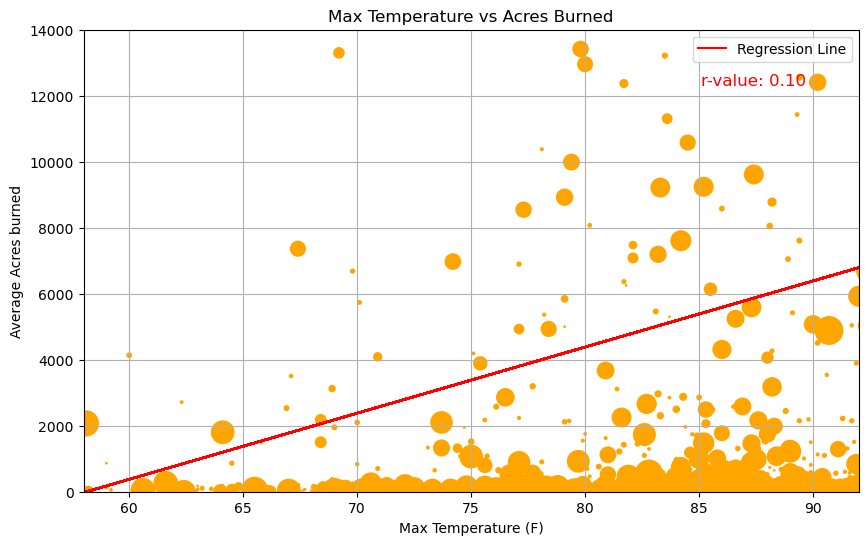

In [25]:
#Create Plot - Acres Burned vs Temperature Scattor Plot by month
plt.figure(figsize=(10, 6))
plt.scatter(gb_year_month_county['Max_Temperature_F'], gb_year_month_county['Acres_Burned_Avg'], s=gb_year_month_county['Duration_Avg_days'], color='orange', marker='o', alpha=1)
plt.xlim(58, 92)
plt.ylim(0, 14000)
plt.title('Max Temperature vs Acres Burned')
plt.xlabel('Max Temperature (F)')
plt.ylabel('Average Acres burned')
plt.grid(True)

# Regression line
x = gb_year_month_county['Max_Temperature_F']
y = gb_year_month_county['Acres_Burned_Avg']
slope, intercept, r_value, p_value, std_err = stats.linregress(x, y)
plt.plot(x, slope * x + intercept, color='red', label='Regression Line')

# Display r-value
plt.text(85.1, 12300, f'r-value: {r_value:.2f}', fontsize=12, color='red')

plt.legend()
plt.show()

### Fire Duration vs Total Rainfall

Correlation coefficient (Pearson's r): 0.03161590272863287


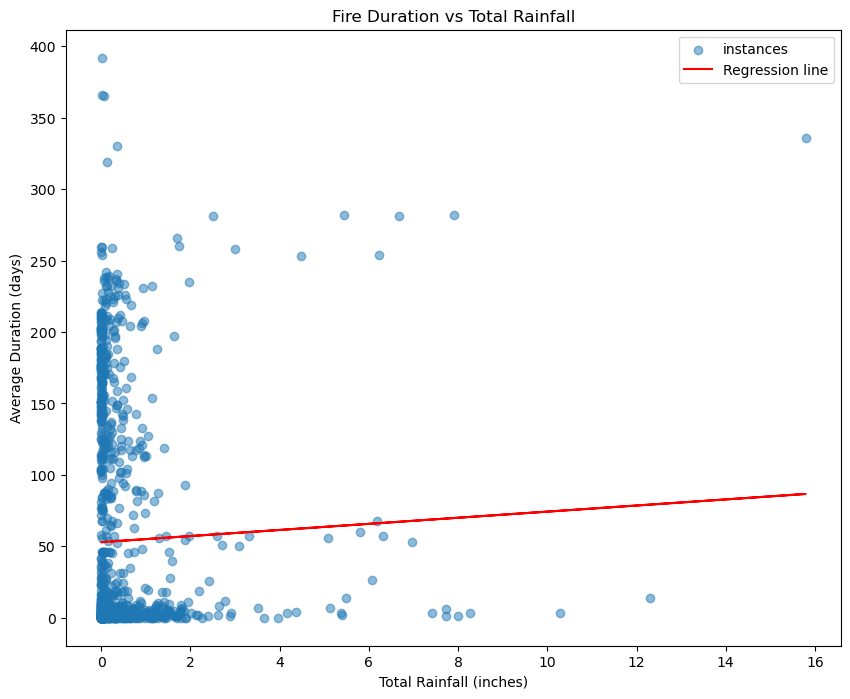

In [26]:
plt.figure(figsize=(10, 8))
plt.scatter(gb_year_month_county['Rainfall_Tot_inches'], gb_year_month_county['Duration_Avg_days'], alpha=0.5, label='instances')
plt.title('Fire Duration vs Total Rainfall')
plt.xlabel('Total Rainfall (inches)')
plt.ylabel('Average Duration (days)')

slope, intercept, r_value, p_value, std_err = linregress(gb_year_month_county['Rainfall_Tot_inches'], gb_year_month_county['Duration_Avg_days'])
dur_vs_rain_regress =  slope * gb_year_month_county['Rainfall_Tot_inches'] + intercept

plt.plot(gb_year_month_county['Rainfall_Tot_inches'], dur_vs_rain_regress, 'r', label='Regression line')
print("Correlation coefficient (Pearson's r):", r_value)
plt.legend()
plt.show()

### Fire Duaration vs Max Temperature

Correlation coefficient (Pearson's r): 0.00622262087742124


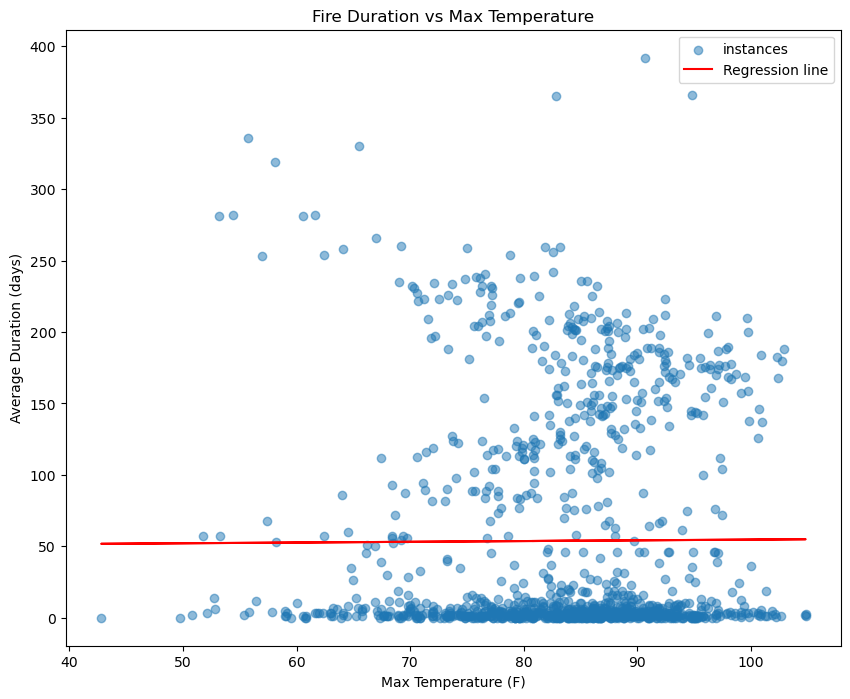

In [27]:
plt.figure(figsize=(10, 8))
plt.scatter(gb_year_month_county['Max_Temperature_F'], gb_year_month_county['Duration_Avg_days'], alpha=0.5, label='instances')
plt.title('Fire Duration vs Max Temperature')
plt.xlabel('Max Temperature (F)')
plt.ylabel('Average Duration (days)')

slope, intercept, r_value, p_value, std_err = linregress(gb_year_month_county['Max_Temperature_F'], gb_year_month_county['Duration_Avg_days'])
dur_vs_temp_regress =  slope * gb_year_month_county['Max_Temperature_F'] + intercept

plt.plot(gb_year_month_county['Max_Temperature_F'], dur_vs_temp_regress, 'r', label='Regression line')
print("Correlation coefficient (Pearson's r):", r_value)
plt.legend()
plt.show()

### Average Rainfall vs Total Fire Incidents by Year

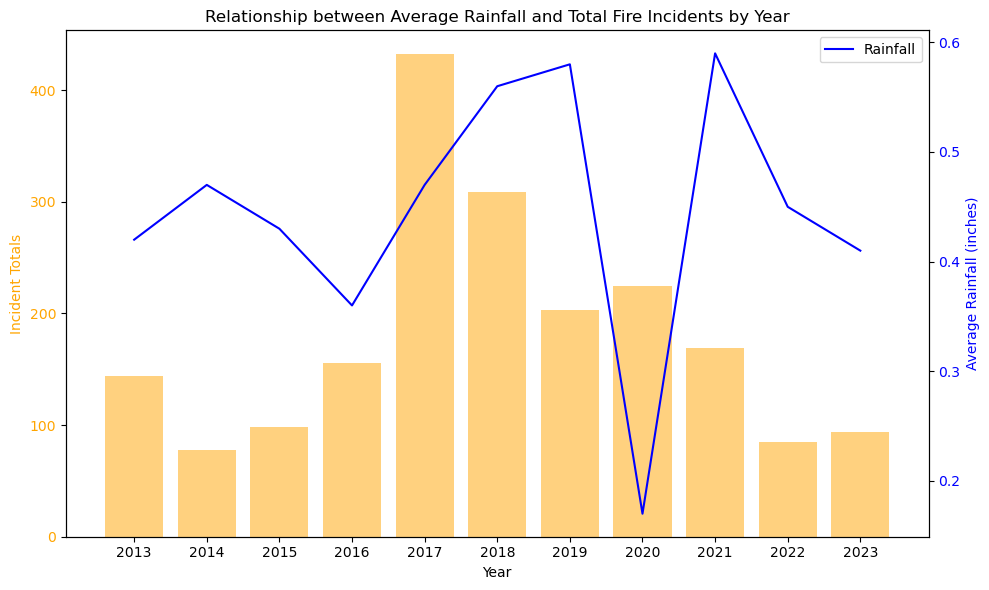

In [28]:
# Creating plot - Relationship between Average Rainfall and Total Fire Incidents by Year
fig, ax1 = plt.subplots(figsize =(10,6))
ax1.bar(gb_year['Year'], gb_year['Incident_Tot'], alpha = 0.5, color ="orange")
ax1.set_xlabel('Year')
ax1.set_ylabel('Incident Totals', color='orange')
ax1.set_xticks(gb_year['Year'])
ax1.tick_params(axis='y', labelcolor='orange')

# Create a second y-axis for sum of acres burned and average acres burned (scaled)
ax2 = ax1.twinx()
#ax2.scatter(years, acres_burned, color='orange', label='Sum Acres Burned')
ax2.plot(gb_year["Year"], gb_year["Rainfall_Avg_inches"], color="blue", label = "Rainfall")
ax2.set_ylabel('Average Rainfall (inches)', color='blue')
ax2.tick_params(axis='y', labelcolor='blue')

# Title and legend
plt.title('Relationship between Average Rainfall and Total Fire Incidents by Year')
fig.tight_layout()
plt.legend()

# Show plot
plt.show()

### Max Temperature vs Total Fire Incidents by Year

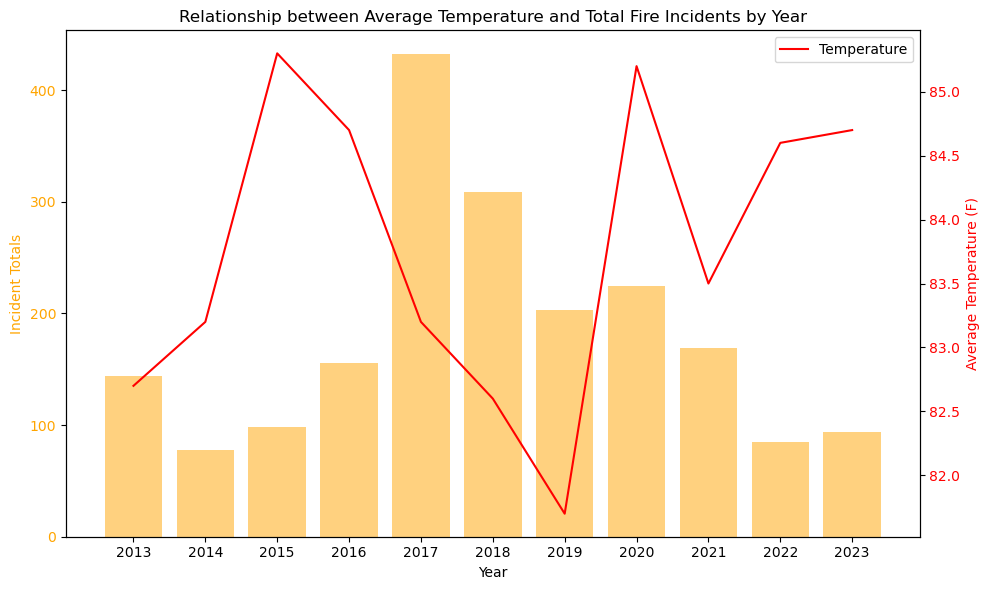

In [29]:
# Creating plot - Relationship between Average Temperature and Total Fire Incidents by Year
fig, ax1 = plt.subplots(figsize =(10,6))
ax1.bar(gb_year['Year'], gb_year['Incident_Tot'], alpha = 0.5, color ="orange")
ax1.set_xlabel('Year')
ax1.set_ylabel('Incident Totals', color='orange')
ax1.set_xticks(gb_year['Year'])
ax1.tick_params(axis='y', labelcolor='orange')

# Create a second y-axis for sum of acres burned and average acres burned (scaled)
ax2 = ax1.twinx()
#ax2.scatter(years, acres_burned, color='orange', label='Sum Acres Burned')
ax2.plot(gb_year["Year"], gb_year["Temperature_Avg_F"], color="red", label = "Temperature")
ax2.set_ylabel('Average Temperature (F)', color='red')
ax2.tick_params(axis='y', labelcolor='red')

# Title and legend
plt.title('Relationship between Average Temperature and Total Fire Incidents by Year')
fig.tight_layout()
plt.legend()

# Show plot
plt.show()

### Average Rainfall vs Total Fire Incidents by Month

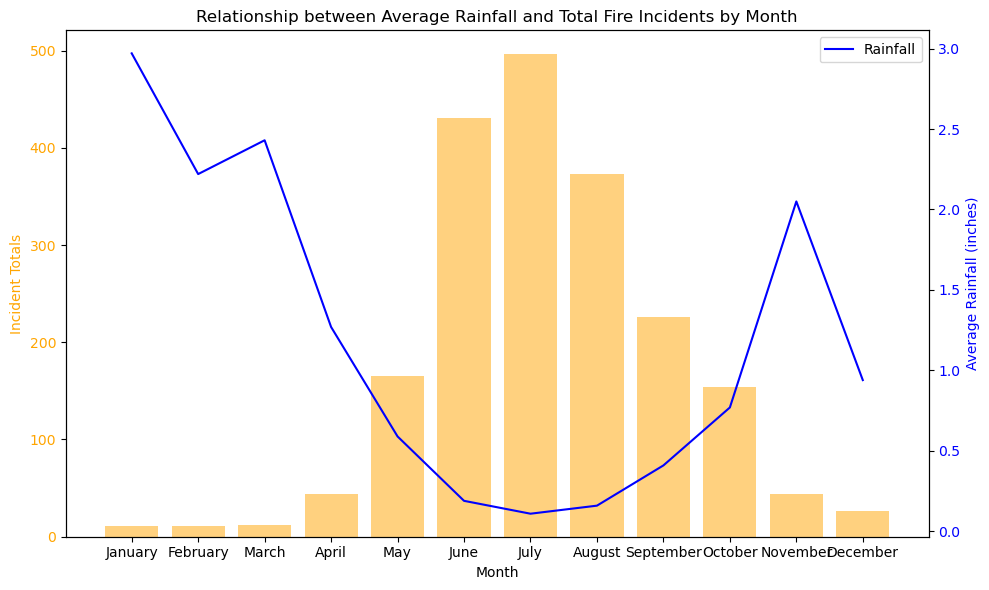

In [30]:
# Creating plot - Relationship between Average Rainfall and Total Fire Incidents by Month
fig, ax1 = plt.subplots(figsize =(10,6))
ax1.bar(gb_month['Month'], gb_month['Incident_Tot'], alpha = 0.5, color ="orange")
ax1.set_xlabel('Month')
ax1.set_ylabel('Incident Totals', color='orange')
ax1.set_xticks(gb_month['Month'])
ax1.tick_params(axis='y', labelcolor='orange')

# Create a second y-axis for sum of acres burned and average acres burned (scaled)
ax2 = ax1.twinx()
#ax2.scatter(years, acres_burned, color='orange', label='Sum Acres Burned')
ax2.plot(gb_month['Month'], gb_month["Rainfall_Avg_inches"], color="blue", label = "Rainfall")
ax2.set_ylabel('Average Rainfall (inches)', color='blue')
ax2.tick_params(axis='y', labelcolor='blue')

# Title and legend
plt.title('Relationship between Average Rainfall and Total Fire Incidents by Month')
fig.tight_layout()
plt.legend()

# Show plot
plt.show()

### Max Temperature vs Total Fire Incidents by Month

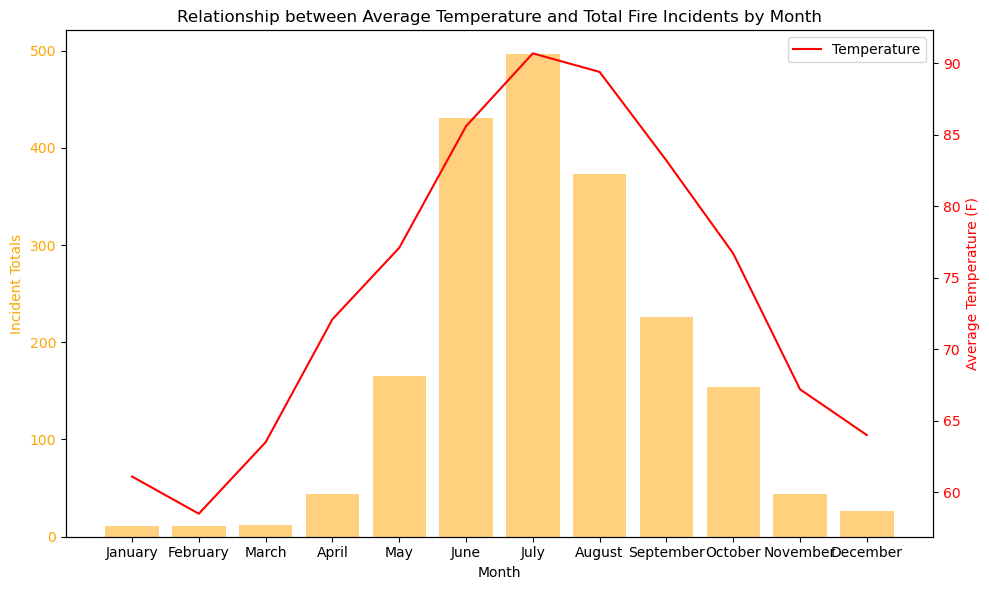

In [31]:
# Creating plot - Relationship between Max Temperature and Total Fire Incidents by Month
fig, ax1 = plt.subplots(figsize =(10,6))
ax1.bar(gb_month['Month'], gb_month['Incident_Tot'], alpha = 0.5, color ="orange")
ax1.set_xlabel('Month')
ax1.set_ylabel('Incident Totals', color='orange')
ax1.set_xticks(gb_month['Month'])
ax1.tick_params(axis='y', labelcolor='orange')

# Create a second y-axis for sum of acres burned and average acres burned (scaled)
ax2 = ax1.twinx()
#ax2.scatter(years, acres_burned, color='orange', label='Sum Acres Burned')
ax2.plot(gb_month['Month'], gb_month["Temperature_Avg_F"], color="red", label = "Temperature")
ax2.set_ylabel('Average Temperature (F)', color='red')
ax2.tick_params(axis='y', labelcolor='red')

# Title and legend
plt.title('Relationship between Average Temperature and Total Fire Incidents by Month')
fig.tight_layout()
plt.legend()

# Show plot
plt.show()

### Average Duration vs Average Acres Burned

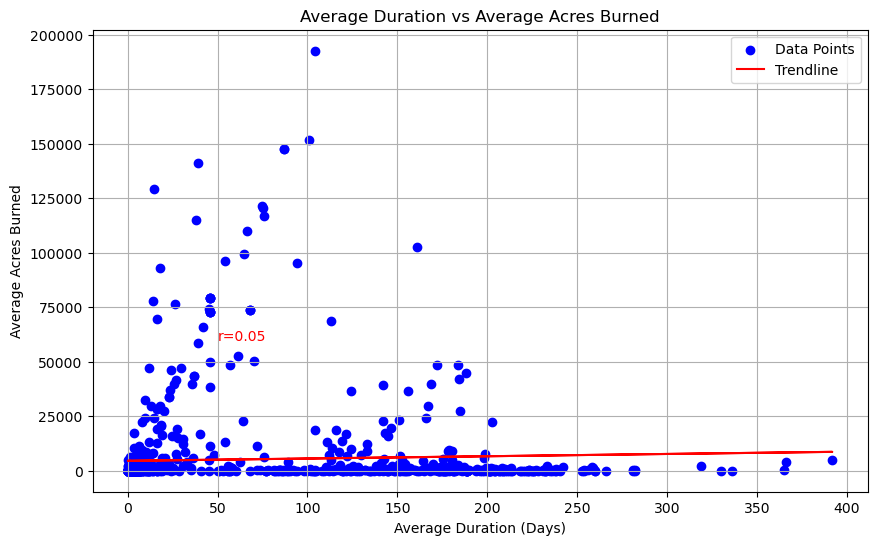

In [32]:
# Data
duration = fire_rain_temp_df['Fire Duration Avg (days)']
acres_burned = fire_rain_temp_df['Acres Burned Avg']

# Fit a trendline (linear regression)
result = stats.linregress(duration, acres_burned)
slope, intercept, r = result.slope, result.intercept, "%0.2f"%result.rvalue

# Plotting
plt.figure(figsize=(10, 6))
plt.scatter(duration, acres_burned, color='blue', label='Data Points')
plt.plot(duration, slope * duration + intercept, color='red', label='Trendline')

# Labels and title
plt.xlabel('Average Duration (Days)')
plt.ylabel('Average Acres Burned')
plt.title('Average Duration vs Average Acres Burned')
plt.legend()

plt.annotate(f'r={r}', (50, 60000), color="r")

# Show plot
plt.grid(True)
plt.show()

### Statistical Summaries of Monthly Fire and Weather Variables

In [33]:
# Create aggregations for variables
acres_stat = fire_rain_temp_df["Acres Burned Avg"].agg(['mean', 'median', 'var', 'std', 'sem', 'max'])
fire_duration_stat = fire_rain_temp_df["Fire Duration Avg (days)"].agg(['mean', 'median', 'var', 'std', 'sem', 'max'])
incident_stat = fire_rain_temp_df["Incident Count Tot"].agg(['mean', 'median', 'var', 'std', 'sem', 'max'])
rain_stat = fire_rain_temp_df["Rainfall (inches)"].agg(['mean', 'median', 'var', 'std', 'sem', 'max'])
temperature_stat = fire_rain_temp_df["Temperature (F)"].agg(['mean', 'median', 'var', 'std', 'sem', 'max'])

# Save results to Dataframe
monthly_stats_summary = pd.DataFrame({
    "Acres Burned": round(acres_stat, 2),
    "Fire Duration (days)": round(fire_duration_stat, 2),
    "Incident Count": round(incident_stat, 2),
    "Rainfall (inches)": round(rain_stat, 2),
    "Temperature (F)": round(temperature_stat, 2)
 })

pd.set_option('display.float_format', lambda x: '%.2f' % x)
monthly_stats_summary

,Acres Burned,Fire Duration (days),Incident Count,Rainfall (inches),Temperature (F)
mean,5105.54,53.84,1.71,0.45,83.60
median,146.00,6.00,1.00,0.07,84.80
var,334053175.14,6198.72,1.77,1.36,90.78
std,18277.12,78.73,1.33,1.16,9.53
sem,535.48,2.31,0.04,0.03,0.28
max,192661.80,392.00,16.00,15.79,104.80


## Top 5 Counties Affected by Fire

Which counties seem to be the most affected by fire (number of incidents and acres burned) over the last 10 years, and how have fluctuations in average monthly rainfall/average maximum temperatures affected this if at all?

### Fire Incident Count per Year for Top 5 Counties

In [34]:
sort_by_incidents = gb_year_month_county.sort_values("Incident_Tot", ascending = False)
sort_by_incidents
county_count = sort_by_incidents.groupby("County")["Incident_Tot"].sum().to_frame().reset_index().sort_values("Incident_Tot", ascending = False)
county_count

top_5_counties = []
for x in range(0,5):
    top_5_counties.append(county_count.iloc[x,0])
top_5_counties 

['Riverside', 'San Diego', 'San Luis Obispo', 'Kern', 'Shasta']

In [35]:
#Create new data frame for top 5 counties
df_top5_counties = gb_year_county.loc[(gb_year_county["County"] == top_5_counties[0]) |\
                (gb_year_county["County"] == top_5_counties[1]) | (gb_year_county["County"] == top_5_counties[2]) |\
                (gb_year_county["County"] == top_5_counties[3]) | (gb_year_county["County"] == top_5_counties[4]) ]


df_top5_counties.head()

,Year,County,Incident_Tot,Acres_Burned_Tot,Acres_Burned_Avg,Duration_Avg_days,Rainfall_Tot_inches,Rainfall_Avg_inches,Temperature_Avg_F
11,2013,Kern,4,4079.00,1174.33,4.80,0.38,0.13,90.90
26,2013,Riverside,18,53538.00,2993.96,1.90,1.48,0.37,96.70
30,2013,San Diego,7,14829.00,1947.25,3.60,2.29,0.57,83.90
32,2013,San Luis Obispo,6,815.00,154.50,0.60,0.47,0.09,81.80
36,2013,Shasta,5,8372.00,2065.12,2.00,3.56,0.89,80.70


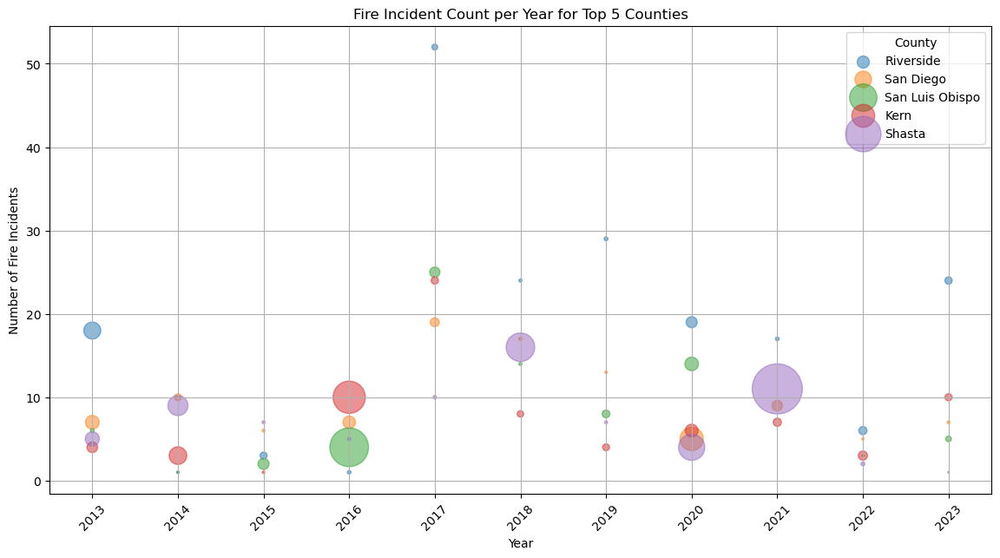

4


In [36]:
plt.figure(figsize=(14, 7))
years_displayed = []

for county in top_5_counties:
    x_values = df_top5_counties.loc[df_top5_counties['County'] == county, 'Year'].tolist()
    y_values = df_top5_counties.loc[df_top5_counties['County'] == county, 'Incident_Tot'].tolist()
    size = df_top5_counties.loc[df_top5_counties['County'] == county, 'Acres_Burned_Avg']/15
    plt.scatter(x_values, y_values, s=size, label=county, alpha=.5)
    years_displayed.extend(x_values)

plt.title('Fire Incident Count per Year for Top 5 Counties')
plt.xlabel('Year')
plt.ylabel('Number of Fire Incidents')
plt.xticks(sorted(set(years_displayed)), rotation = 45)
plt.annotate("Size of marker is scaled with average acres burned.", xy=(2013,-2))
plt.legend(title='County')
plt.grid(True)
plt.show()
print(x)

### Average Annual Max Temperature (F) and Top 5 Counties by Total Acres Burned

In [37]:
df_top5_counties_geo = rain_temp_mapping.loc[rain_temp_mapping["County"].isin(list(set(df_top5_counties["County"])))]
df_top5_counties_geo.head()

,County,Centroid_LAT,Centroid_LON,geometry,Incident_Tot,Acres_Burned_Tot,Acres_Burned_Avg,Duration_Avg_days,Rainfall_Tot_inches,Rainfall_Avg_inches,Temperature_Avg_F,Acres_Burned_Avg_scaled
8,San Diego,33.02,-116.78,"POLYGON ((-116.757 32.566, -116.783 32.563, -1...",105.00,76621.00,984.88,38.80,16.77,0.34,85.20,98.49
15,Shasta,40.76,-122.04,"POLYGON ((-121.323 40.585, -121.323 40.585, -1...",77.00,586379.13,5493.64,45.60,36.11,0.84,83.90,549.36
31,Riverside,33.73,-116.00,"POLYGON ((-114.767 33.434, -114.767 33.434, -1...",194.00,120527.50,634.58,51.80,13.35,0.26,90.30,63.46
32,Kern,35.35,-118.73,"POLYGON ((-118.882 34.818, -118.882 34.818, -1...",80.00,146654.00,1739.59,47.30,7.01,0.19,89.00,173.96
57,San Luis Obispo,35.39,-120.45,"POLYGON ((-120.719 35.110, -120.722 35.111, -1...",82.00,107095.50,1861.24,49.70,4.41,0.12,84.20,186.12


In [38]:
# Plot temperature
cali_maxtemp_plot3 = rain_temp_mapping.hvplot(
    geo=True, 
    c='Temperature_Avg_F', 
    cmap='Summer', 
    tiles = "OSM",
    alpha=0.7,
    width=800, 
    height=600, 
    title="Average Annual Temperature (F) Top 5 Counties by Total Acres Burned",
    hover_cols=['County', 'Temperature_Avg_F'],
    colorbar=True, 
    clabel = "Mean Temperature (F)")

# Plot fire locations
fire_locations_top5 = df_top5_counties_geo.hvplot.points(
    'Centroid_LON', 
    'Centroid_LAT',
    geo = True,
    tiles = "OSM",
    frame_width = 700,
    frame_height = 500,
    size='Acres_Burned_Tot',
    scale=0.05,
    color='red', 
    alpha=0.5,
    hover_cols=["County","Acres_Burned_Tot"],
    label="Acres_Burned_Tot")


# Display the map
combined_plot3 = cali_maxtemp_plot3 * fire_locations_top5
combined_plot3

:Overlay
   .WMTS.I                  :WMTS   [Longitude,Latitude]
   .Polygons.I              :Polygons   [Longitude,Latitude]   (Temperature_Avg_F,County)
   .WMTS.II                 :WMTS   [Longitude,Latitude]
   .Points.Acres_Burned_Tot :Points   [Centroid_LON,Centroid_LAT]   (Acres_Burned_Tot,County)